# Anime Face Generation
In the final project, you'll learn to define and train a GAN on a dataset of anime faces. The goal is to obtain a generator network to generate images of anime faces that look very cute and cartoon!

The final project includes several tasks, from loading data and training a GAN. At the end of the notebook, you will be able to visualize the results of the trained generator to understand its performance; the samples you generate should look like fairly anime faces with a small amount of noise.

**In this project, we encourage students to think about how to improve the performance of GAN and the stability of training. Students can write the experimental results and analysis into the report. This part will be used as a bonus item.**



## Download the data
You can use this link [Anime Face dataset](https://www.kaggle.com/lunarwhite/anime-face-dataset-ntumlds) to download dataset for training your adversarial networks.

This is an dataset consisting of 36.7k high-quality anime faces. We suggest that you utilize a GPU for training.

In [1]:
#import necessary libraries
import torch, torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch import nn, optim
from torchvision.utils import make_grid
from torchvision.utils import save_image
from tqdm.notebook import tqdm
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
import random
from PIL import Image
%matplotlib inline
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))
#TODO: define your own dataset address"
root = './Class/'

## Visualize the input image
Note that these are color images with 3 color channels (RGB) each.

36740


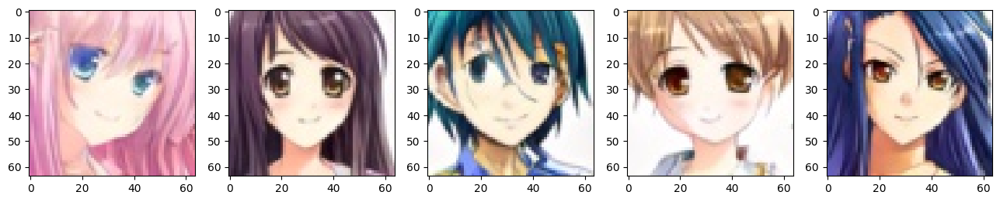

In [5]:
#TODO：randomly choose images to visualize
img_list = []
for root, dirs, files in os.walk(root, topdown=False):
    for name in files:
        img = os.path.join(root, name)
        img_list.append(img)
print(len(img_list))

r_idx = random.sample(range(0,36740),5)
plt.figure(figsize=(16,8))
for i in range(len(r_idx)):
    img = Image.open(img_list[r_idx[i]])
    plt.subplot(1,5,i+1)
    plt.imshow(img)

## Pre-process and Load the Data
Based on the previous knowledge, students are required to complete the code for preprocessing and data loading. 
### For preprocessing 
we recommend students to use `transforms` in `torchvision`. Students are required to fill in at least two items: `Resize` and `CenterCrop`. Students can also try other **data augumentation methods** and display the results in the final report as a **bonus item**.
### Load the Data
In this part, you need define your own `Dataset` to load training images. For GAN, you don't need to load label data. Thus, defining the Dataset is easier than previous assignments.

In [6]:
# Preprocessing methods
# The batch_size is defined by the memory of GPU or CPU.
df = pd.DataFrame(img_list)
df.to_csv('data.csv', index=False, header = None)

batch_size = 64
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
transform = transforms.Compose([transforms.Resize(64),
                                transforms.CenterCrop(64),
                                transforms.ToTensor(),
                                transforms.Normalize(*stats)])
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]
# Dataset and Dataloader.

class AnimeData(Dataset):
    """
    Wrap the data into a Dataset class, and then pass it to the DataLoader
    :__init__: Initialization data
    :__getitem__: support the indexing such that dataset[i] can be used to get ith sample
    :__len__: return the size of the dataset.
    """
    
    def __init__(self, root, transform=None):
        self.transform = transform
        self.data = pd.read_csv(root,header=None)
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, index):
        image_name = self.frame.iloc[index, 0]
        image = Image.open(image_name)
        image = self.transform(image)
        return image

# Trainloader 
trainset = AnimeData('data.csv', transform=transform)
trainloader = DataLoader(trainset, batch_size=64, shuffle=True, num_workers=0)

## Check your device and move data to device
In this part, students can check whether the computer's GPU is available and move the data to the GPU (or CPU). We strongly recommend that students use GPU to speed up the program. 

`torch.cuda.is_available` can help us to check whether GPU is available.

In [8]:
if torch.cuda.is_available():
    device=torch.device('cuda')
else:
    device=torch.device('cpu')

## Define a GAN
A GAN consists of two adversarial networks, a discriminator and a generator.
### Discriminator
Your first task will be to define the discriminator. This is a convolutional classifier like you've built before, only without any maxpooling layers. 
#### Exercise: Complete the Discriminator class
* The inputs to the discriminator are 3x64x64 tensor images
* The output should be a single value that will indicate whether a given image is real or fake

An example of our discriminant model is as follows, and students can also define it by themselves, including adjusting the model structure and activation function. We recommend that students use `nn.Sequential` to define the model, which is more simple and intuitive.
<img src='./img/d.png' width=80% />

**Students can build models based on examples, but we suggest you try different models (including model structure and activation function). This will be regared as a bonus.**

In [9]:
#TODO: Create your Discriminator model
class Discriminator(nn.Module):
    def __init__(self,inchannels):
        super(Discriminator,self).__init__()
        """
        Initialize the Discriminator Module
        :param inchannels: The depth of the first convolutional layer
        """
        self.seq = nn.Sequential(
            
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True), 
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Flatten(),
            nn.Sigmoid()
            
        )
        
    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network     
        :return: Discriminator logits; the output of the neural network
        """
        x = self.seq(x)
        return x
        
D=Discriminator(3).to(device)

## Generator

The generator should upsample an input and generate a *new* image of the same size as our training data `3x64x64`. This should be mostly transpose convolutional layers `nn.ConvTranspose2d` with normalization applied to the outputs.

#### Exercise: Complete the Generator model
* The inputs to the generator are vectors of some length `latent_size`
* The output should be a image of shape `3x64x64`

The example of Generator is as follows. 
<img src='./img/g.png' width=80% />

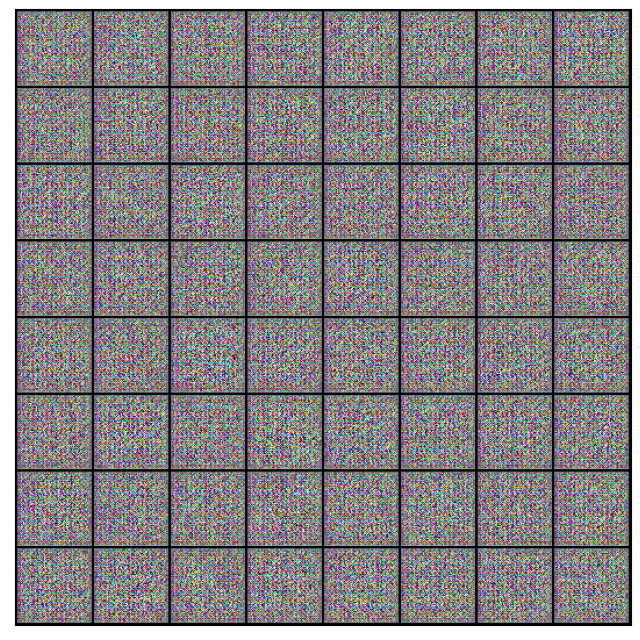

In [10]:
#TODO: Create your Generator model
latent_size = 128
class Generator(nn.Module):
    def __init__(self,latent_size):
        super(Generator,self).__init__()
        """
        Initialize the Generator Module
        :param latent_size: The length of the input latent vector
        """
        
        self.seq = nn.Sequential(
            
            nn.ConvTranspose2d(in_channels=latent_size, out_channels=512, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
            
        )
        
    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network     
        :return: A 3x64x64 Tensor image as output
        """
        
        
        x = self.seq(x)
        return x
        
G=Generator(latent_size).to(device) 
# random latent tensors
noise = torch.randn(batch_size, latent_size, 1, 1).to(device) 
#TODO: use generator model to generate fake image 
fake_images = G(noise).to(device) 


#TODO: visualize the fake images by function show_images
show_images(fake_images.to(torch.device('cpu')))

---
## Discriminator and Generator Losses

Now we need to calculate the losses for both types of adversarial networks.

### Discriminator Losses

> * For the discriminator, the total loss is the sum of the losses for real and fake images, `d_loss = d_real_loss + d_fake_loss`. 
* Remember that we want the discriminator to output 1 for real images and 0 for fake images, so we need to set up the losses to reflect that.


### Generator Loss

The generator loss will look similar only with flipped labels. The generator's goal is to get the discriminator to *think* its generated images are *real*.

#### Exercise: Complete real and fake loss functions

**You may choose to use either cross entropy or a least squares error loss to complete the following `real_loss` and `fake_loss` functions. We also encourage students to use the loss function in other related papers as a bonus item. If you use it, please include a citation in the report**

In [11]:
#TODO：Complete the loss function for training GAN
loss_func = nn.BCELoss()
def Real_loss(preds,targets):
    '''
       Calculates how close discriminator outputs are to being real.
       param, D_out: discriminator logits
       return: real loss
    '''
    loss=loss_func(preds,targets)
    return loss
def Fake_loss(preds,targets):
    '''
       Calculates how close discriminator outputs are to being fake.
       param, D_out: discriminator logits
       return: fake loss
    '''
    loss=loss_func(preds,targets)
    return loss

## Optimizers

#### Exercise: Define optimizers for your Discriminator (D) and Generator (G)

Define optimizers for your models with appropriate hyperparameters.

In [12]:
# Create optimizers for the discriminator D and generator G
#Define your learning rate
lr=0.0002
opt_d = optim.Adam(D.parameters(),lr=lr/2,betas=(0.5,0.999),weight_decay=0.0005)
opt_g = optim.Adam(G.parameters(),lr=lr,betas=(0.5,0.999),weight_decay=0.0005)

### Save the generated images
This code can help you save images generated from Generator G

In [13]:
##Define your save path.
sample_dir = 'generated_images'
os.makedirs(sample_dir, exist_ok=True)
def save_samples(index, latent_tensors, generator, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
        plt.show()
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

## Training GAN to generate anime faces
Training will involve alternating between training the discriminator and the generator. You'll use your functions `real_loss` and `fake_loss` to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function


#### Saving Samples

You've been given some code to save some generated "fake" samples.

#### Exercise: Complete the training function

Keep in mind that, if you've moved your models to GPU, you'll also have to move any model inputs to GPU.

  0%|          | 0/575 [00:00<?, ?it/s]

/usr/local/lib64/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib64/python3.9/site-packages/numpy/core/fromnumeric.py:86: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/usr/local/lib64/pyt

Epoch [1/40], loss_g: 3.4207, loss_d: 0.6230, real_score: 0.8639, fake_score: 0.2576
Saving generated-images-0001.png


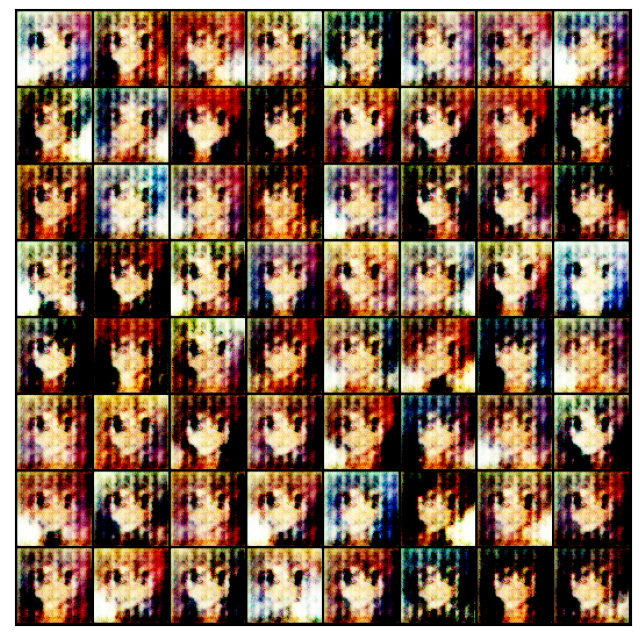

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [2/40], loss_g: 4.1226, loss_d: 1.1851, real_score: 0.8302, fake_score: 0.5801
Saving generated-images-0002.png


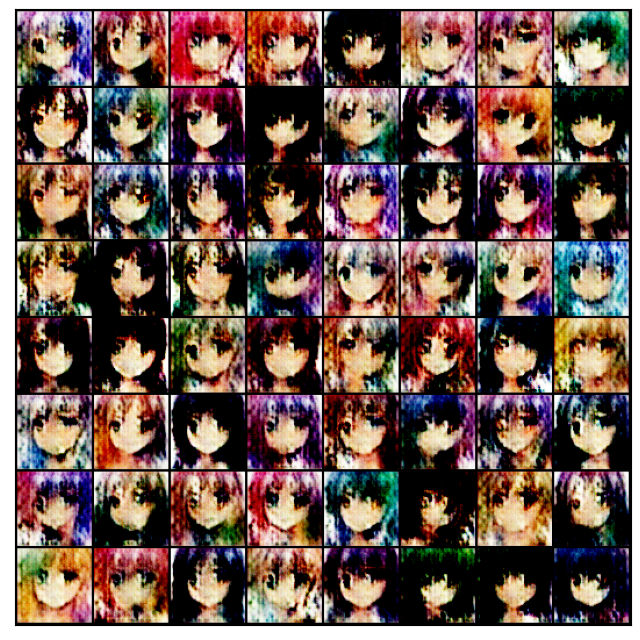

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [3/40], loss_g: 1.2659, loss_d: 0.9934, real_score: 0.5427, fake_score: 0.2674
Saving generated-images-0003.png


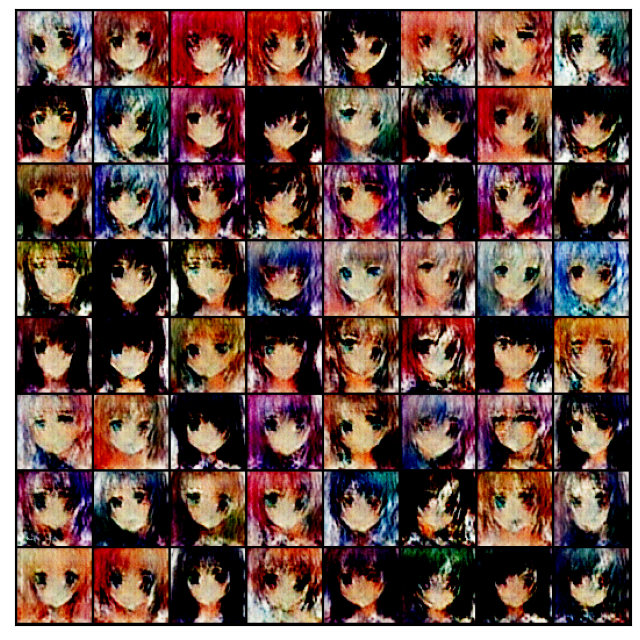

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [4/40], loss_g: 0.2305, loss_d: 2.8042, real_score: 0.0733, fake_score: 0.1896
Saving generated-images-0004.png


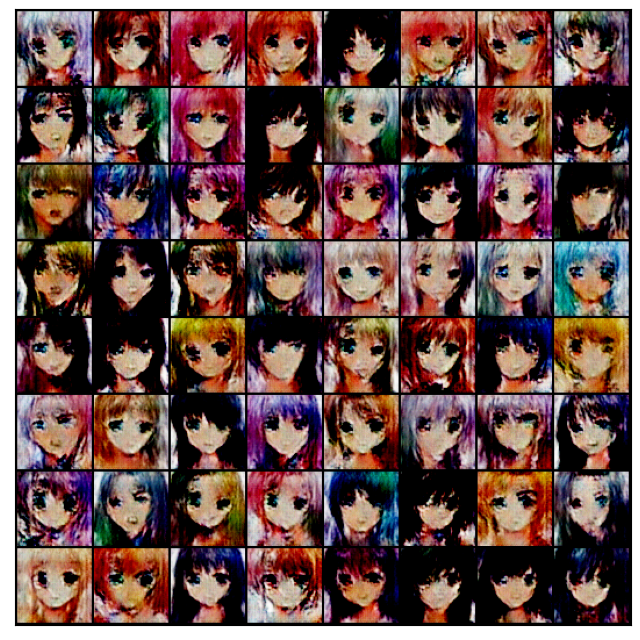

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [5/40], loss_g: 0.6006, loss_d: 1.2511, real_score: 0.4442, fake_score: 0.2855
Saving generated-images-0005.png


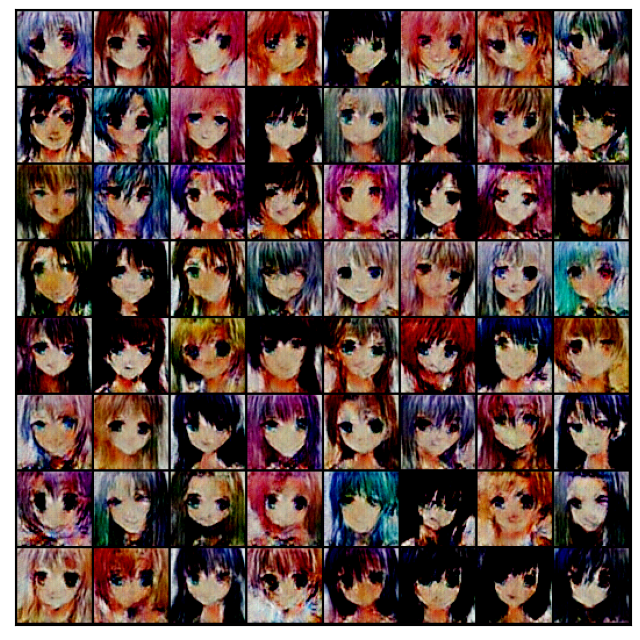

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [6/40], loss_g: 2.4993, loss_d: 0.6831, real_score: 0.7877, fake_score: 0.2470
Saving generated-images-0006.png


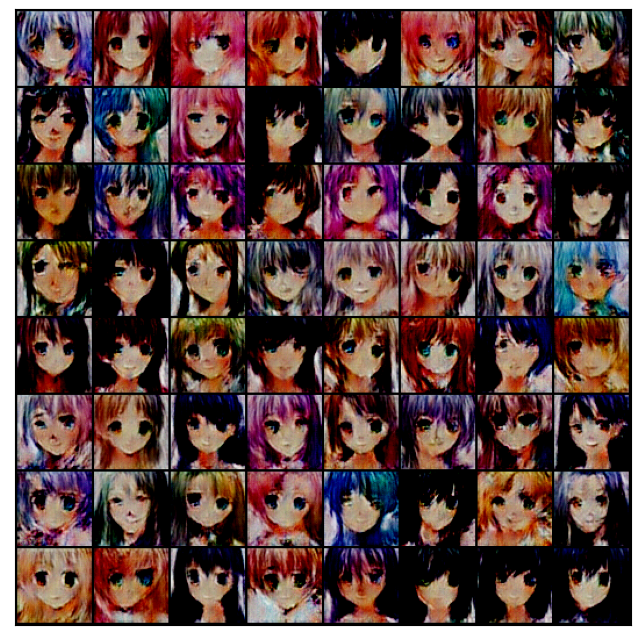

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [7/40], loss_g: 3.2657, loss_d: 1.1184, real_score: 0.8318, fake_score: 0.5352
Saving generated-images-0007.png


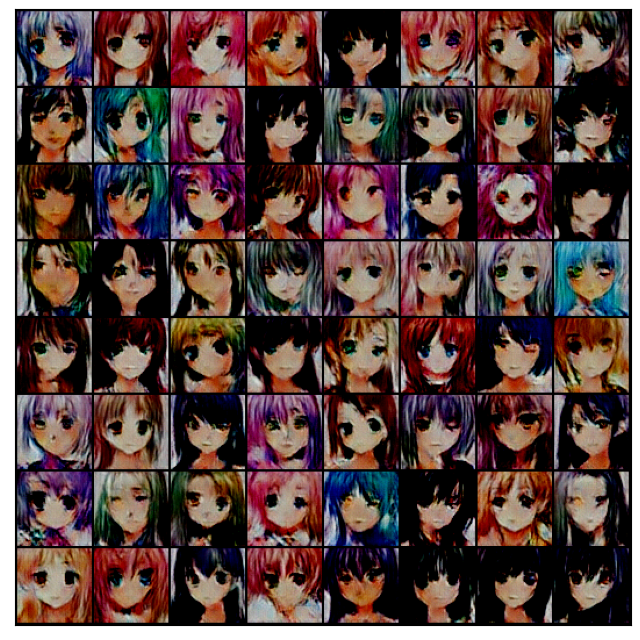

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [8/40], loss_g: 1.0825, loss_d: 1.2094, real_score: 0.3704, fake_score: 0.0302
Saving generated-images-0008.png


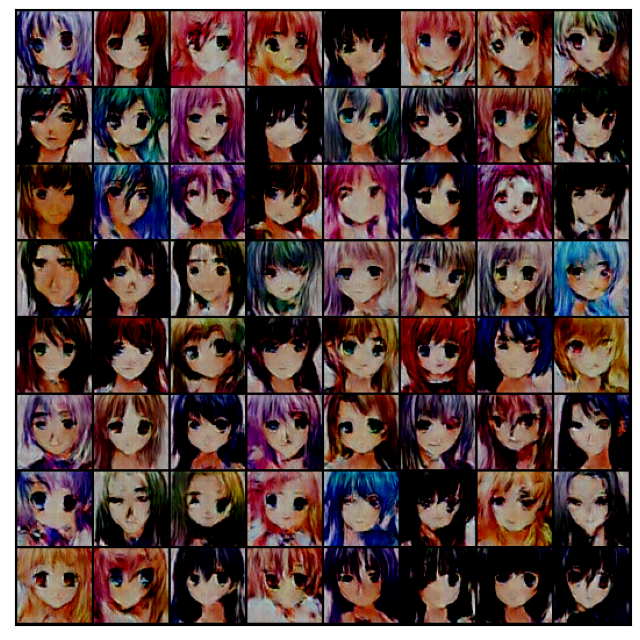

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [9/40], loss_g: 3.2981, loss_d: 0.6506, real_score: 0.8843, fake_score: 0.2701
Saving generated-images-0009.png


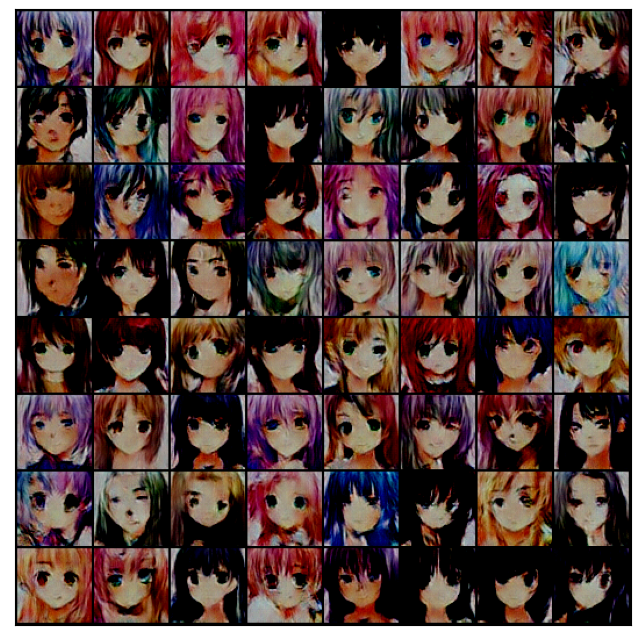

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [10/40], loss_g: 2.2322, loss_d: 0.5536, real_score: 0.8443, fake_score: 0.1854
Saving generated-images-0010.png


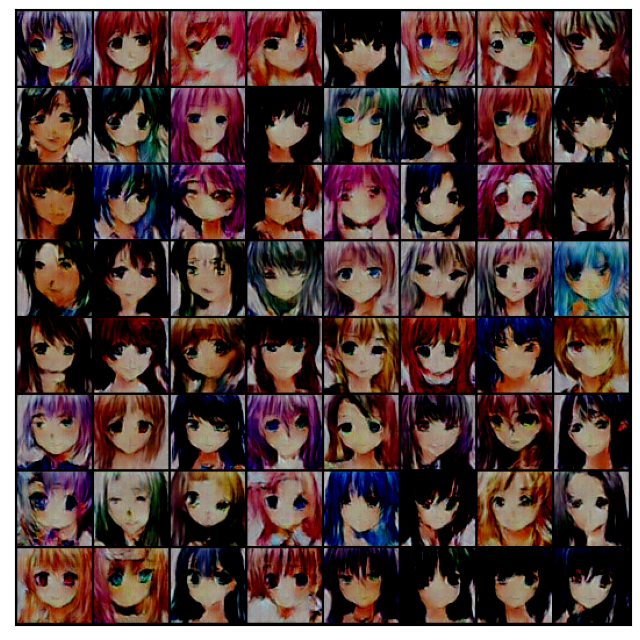

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [11/40], loss_g: 3.1520, loss_d: 0.4341, real_score: 0.8673, fake_score: 0.0882
Saving generated-images-0011.png


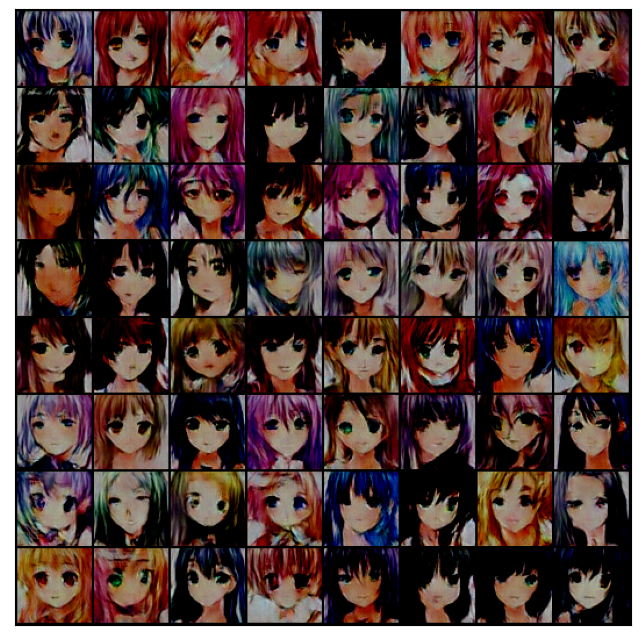

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [12/40], loss_g: 2.6657, loss_d: 0.6239, real_score: 0.8321, fake_score: 0.2395
Saving generated-images-0012.png


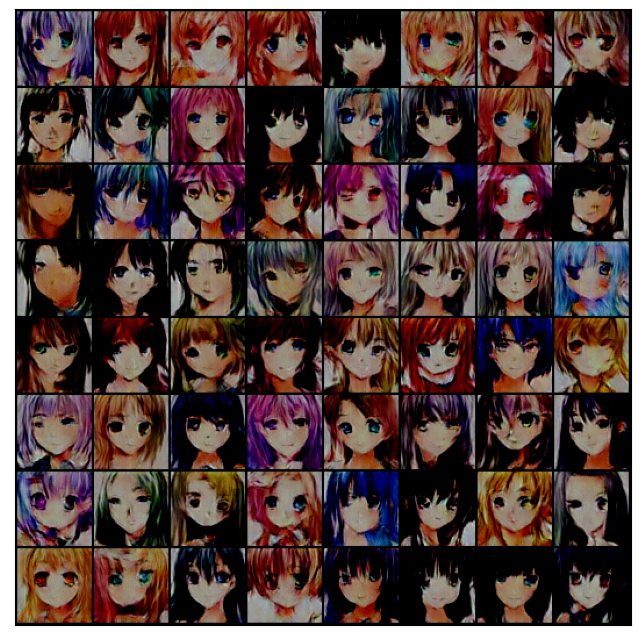

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [13/40], loss_g: 0.2473, loss_d: 1.3452, real_score: 0.3820, fake_score: 0.2281
Saving generated-images-0013.png


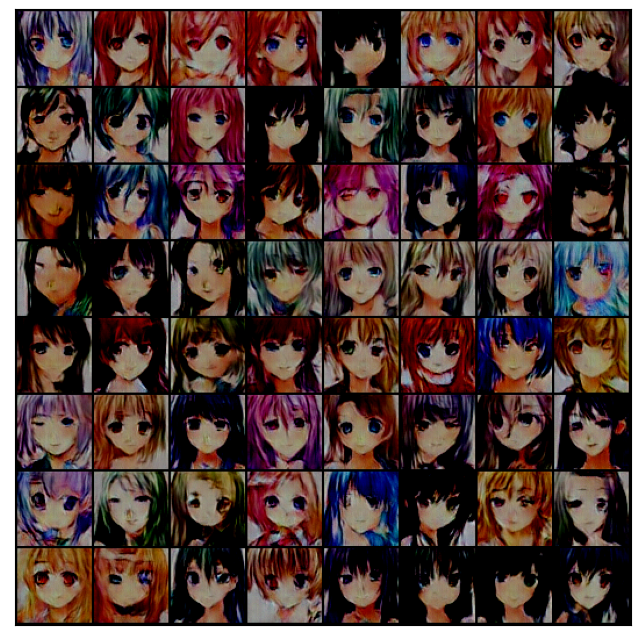

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [14/40], loss_g: 0.0329, loss_d: 1.7874, real_score: 0.2428, fake_score: 0.0902
Saving generated-images-0014.png


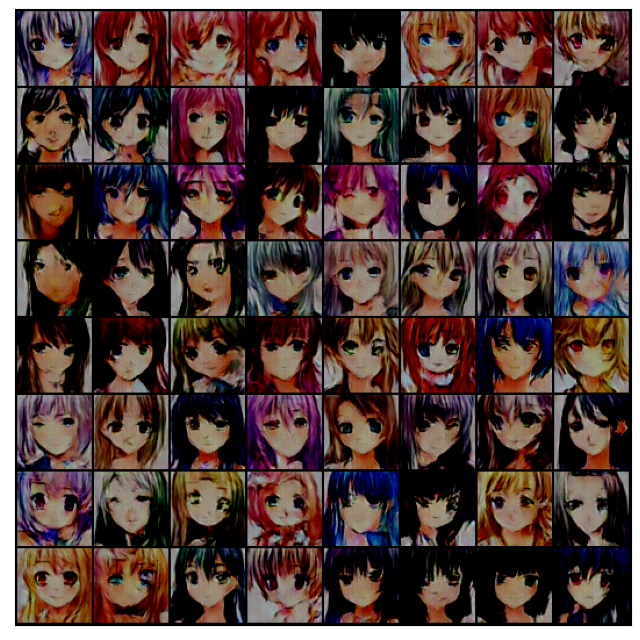

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [15/40], loss_g: 0.1836, loss_d: 1.2848, real_score: 0.3351, fake_score: 0.0408
Saving generated-images-0015.png


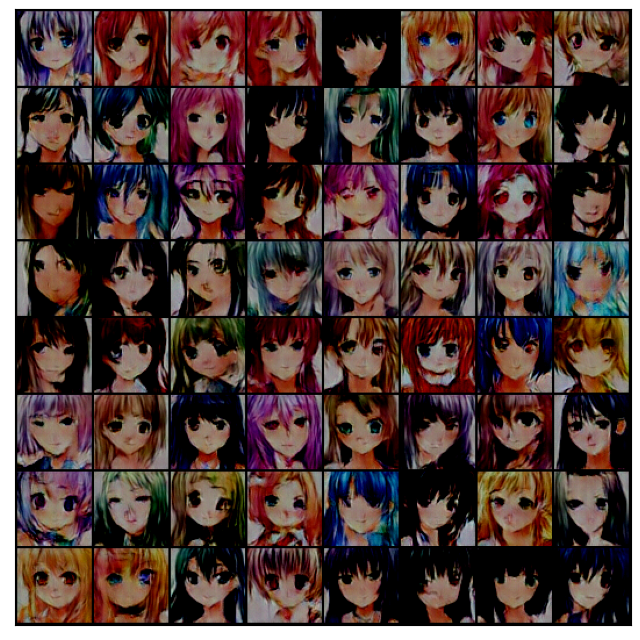

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [16/40], loss_g: 2.1861, loss_d: 0.4362, real_score: 0.8719, fake_score: 0.0772
Saving generated-images-0016.png


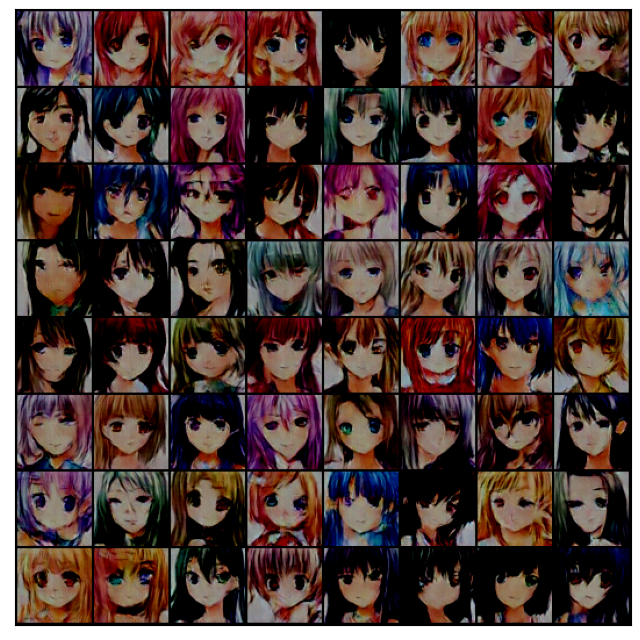

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [17/40], loss_g: 0.8636, loss_d: 0.6583, real_score: 0.6840, fake_score: 0.1013
Saving generated-images-0017.png


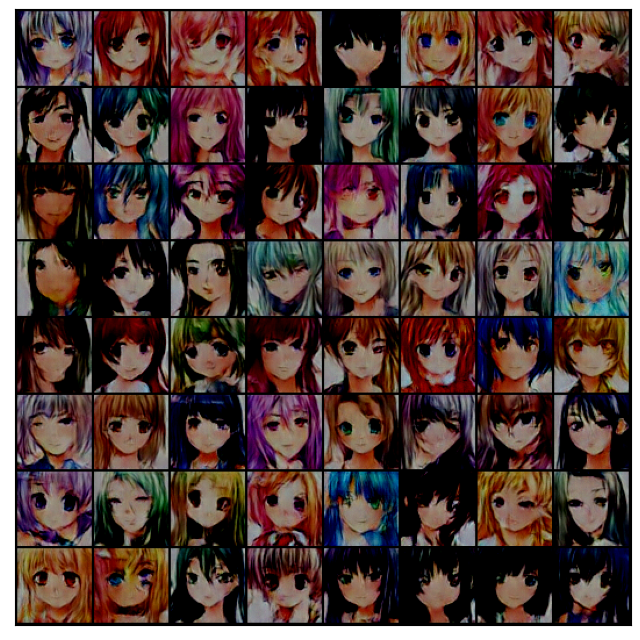

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [18/40], loss_g: 3.4729, loss_d: 0.5441, real_score: 0.9246, fake_score: 0.2029
Saving generated-images-0018.png


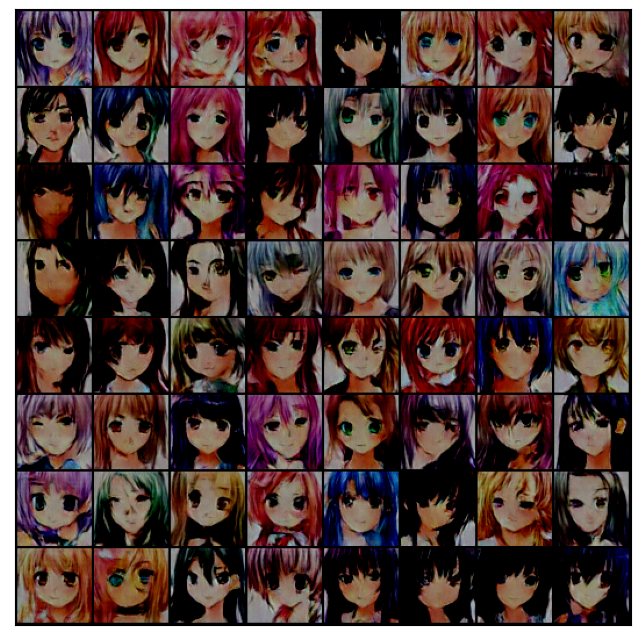

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [19/40], loss_g: 2.1120, loss_d: 0.5834, real_score: 0.7995, fake_score: 0.1018
Saving generated-images-0019.png


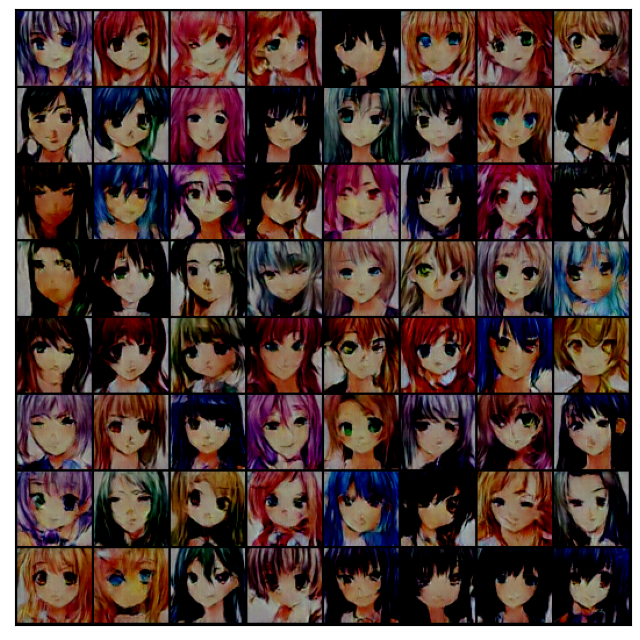

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [20/40], loss_g: 0.5884, loss_d: 0.9021, real_score: 0.5492, fake_score: 0.0339
Saving generated-images-0020.png


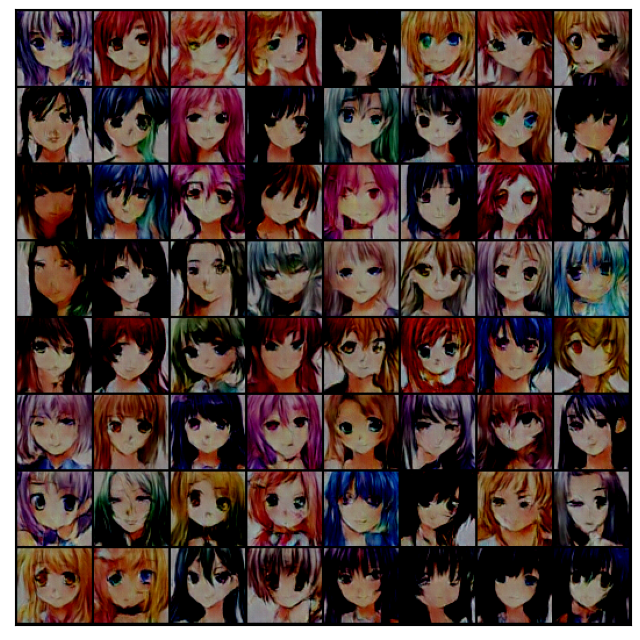

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [21/40], loss_g: 0.7645, loss_d: 0.8503, real_score: 0.6295, fake_score: 0.0858
Saving generated-images-0021.png


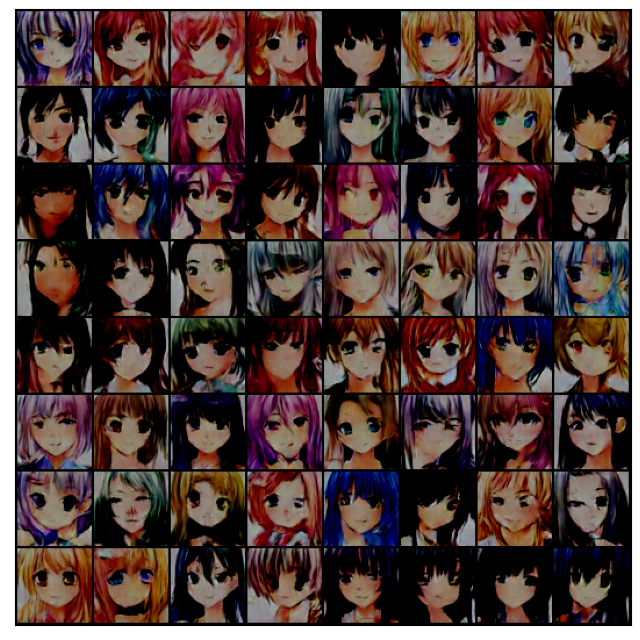

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [22/40], loss_g: 3.4946, loss_d: 0.4963, real_score: 0.8851, fake_score: 0.0315
Saving generated-images-0022.png


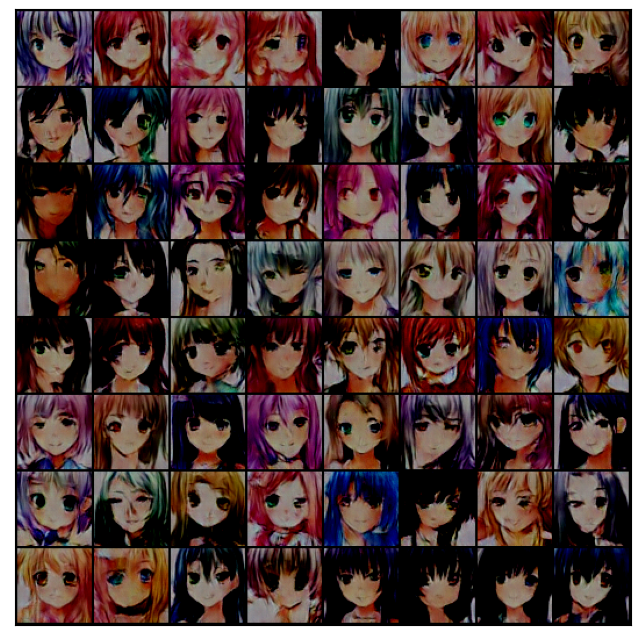

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [23/40], loss_g: 3.6068, loss_d: 0.5356, real_score: 0.9835, fake_score: 0.0996
Saving generated-images-0023.png


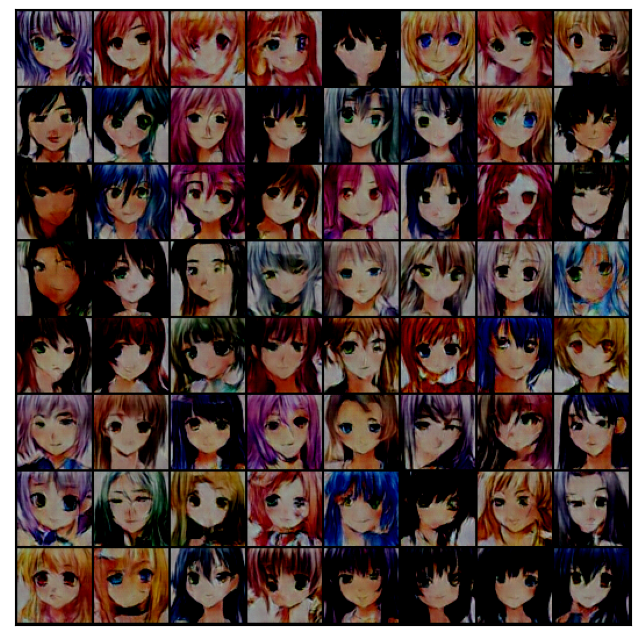

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [24/40], loss_g: 4.6044, loss_d: 0.8146, real_score: 0.8507, fake_score: 0.4046
Saving generated-images-0024.png


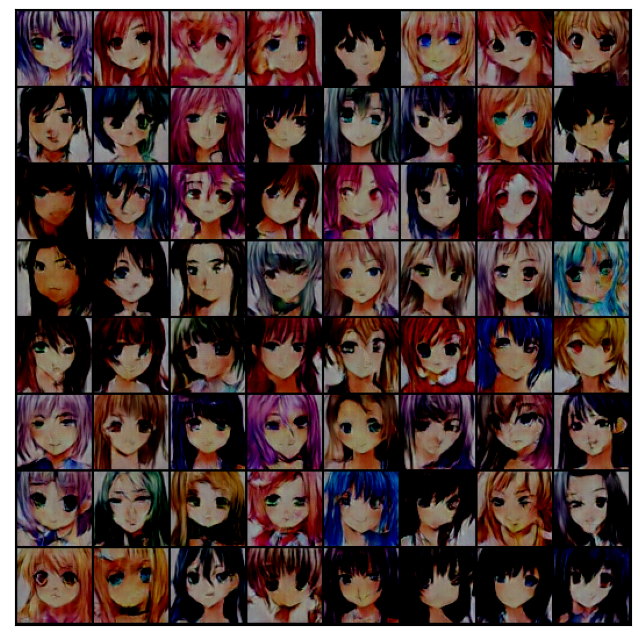

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [25/40], loss_g: 1.6062, loss_d: 1.3817, real_score: 0.3696, fake_score: 0.0018
Saving generated-images-0025.png


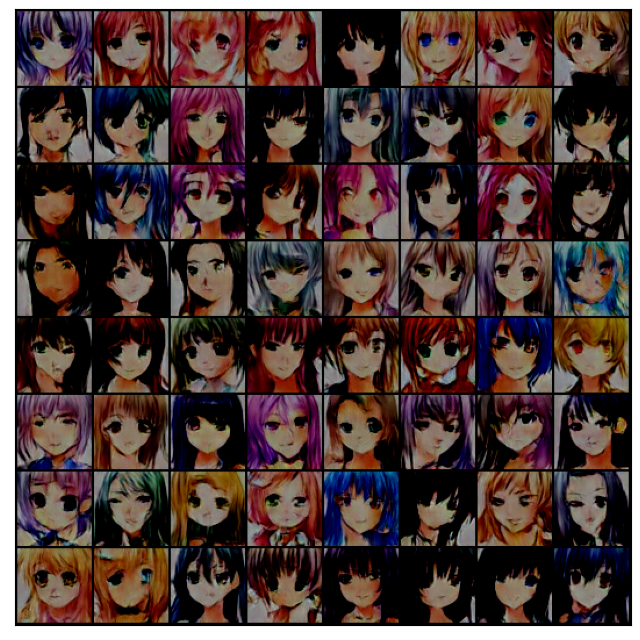

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [26/40], loss_g: 0.5332, loss_d: 1.1181, real_score: 0.4092, fake_score: 0.0325
Saving generated-images-0026.png


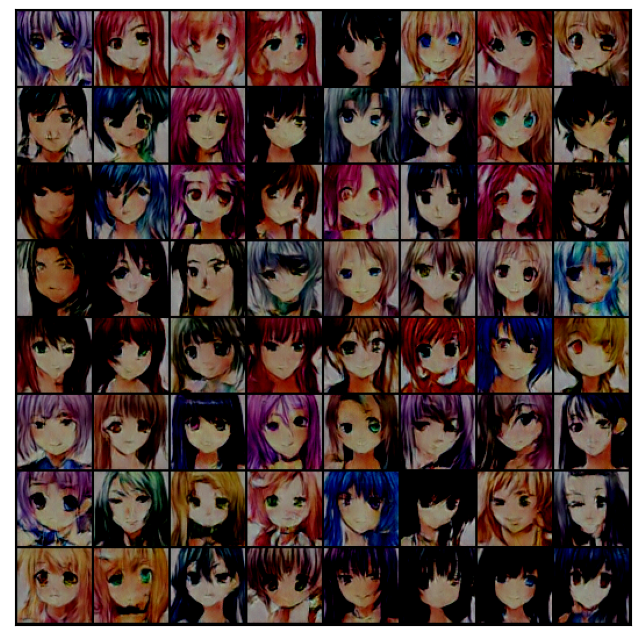

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [27/40], loss_g: 1.8837, loss_d: 0.4733, real_score: 0.8534, fake_score: 0.0415
Saving generated-images-0027.png


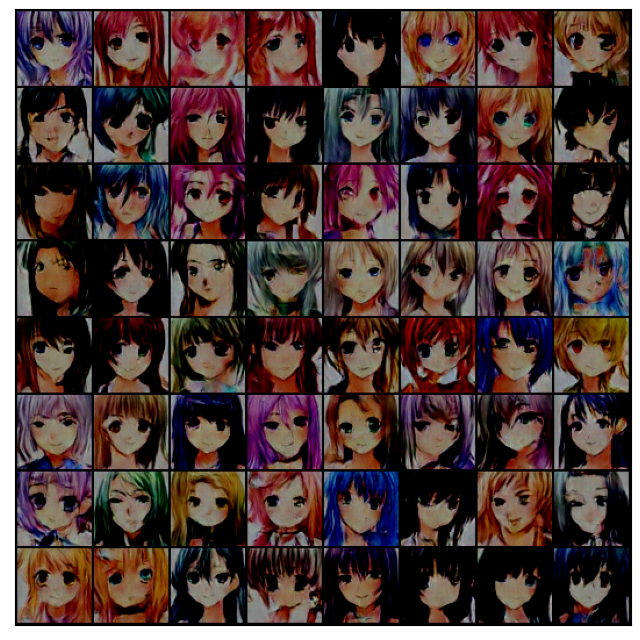

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [28/40], loss_g: 0.3320, loss_d: 1.0938, real_score: 0.4352, fake_score: 0.0122
Saving generated-images-0028.png


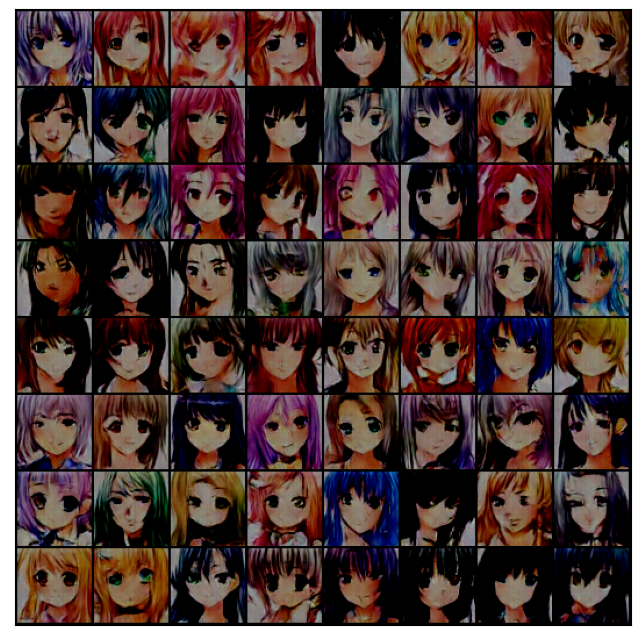

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [29/40], loss_g: 1.3838, loss_d: 0.6731, real_score: 0.6809, fake_score: 0.0460
Saving generated-images-0029.png


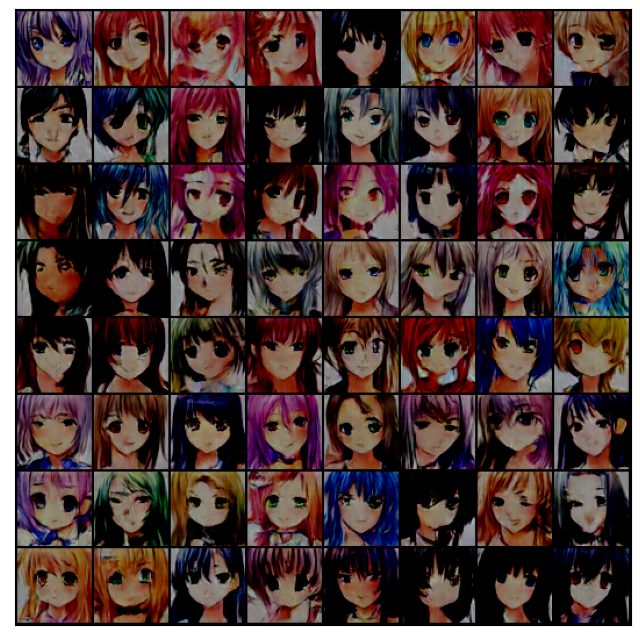

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [30/40], loss_g: 0.1713, loss_d: 1.3511, real_score: 0.3775, fake_score: 0.0331
Saving generated-images-0030.png


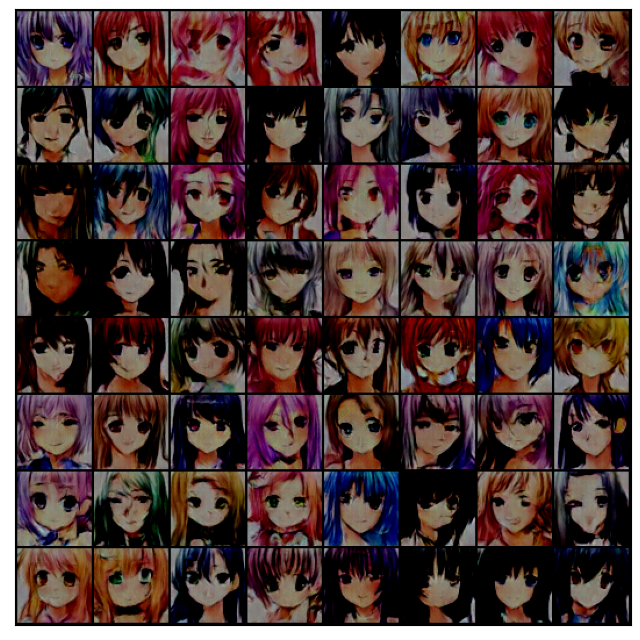

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [33/40], loss_g: 4.9971, loss_d: 0.7124, real_score: 0.9241, fake_score: 0.3313
Saving generated-images-0033.png


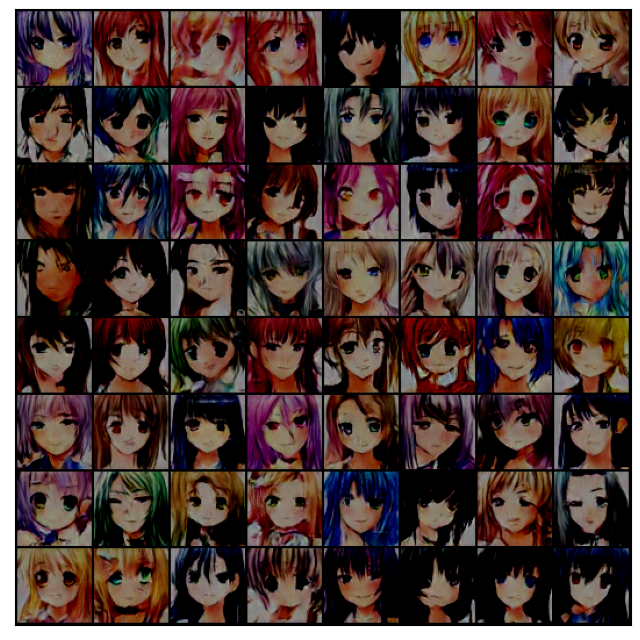

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [34/40], loss_g: 3.2691, loss_d: 0.5559, real_score: 0.9081, fake_score: 0.2574
Saving generated-images-0034.png


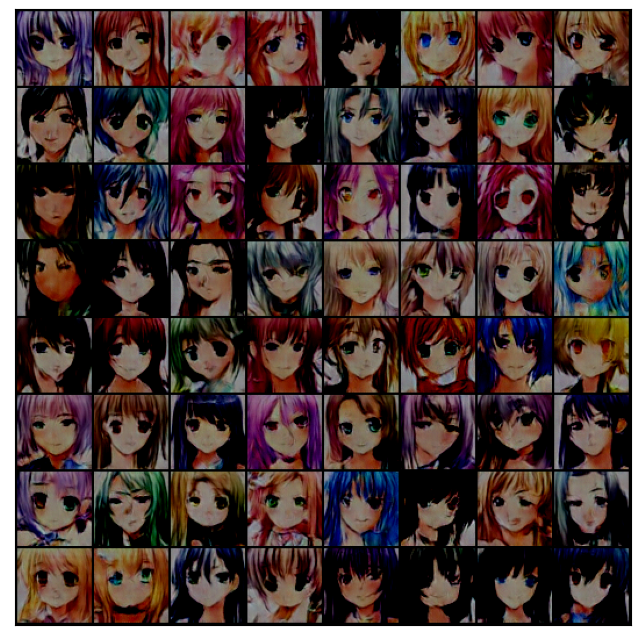

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [35/40], loss_g: 2.9188, loss_d: 0.5078, real_score: 0.8900, fake_score: 0.0841
Saving generated-images-0035.png


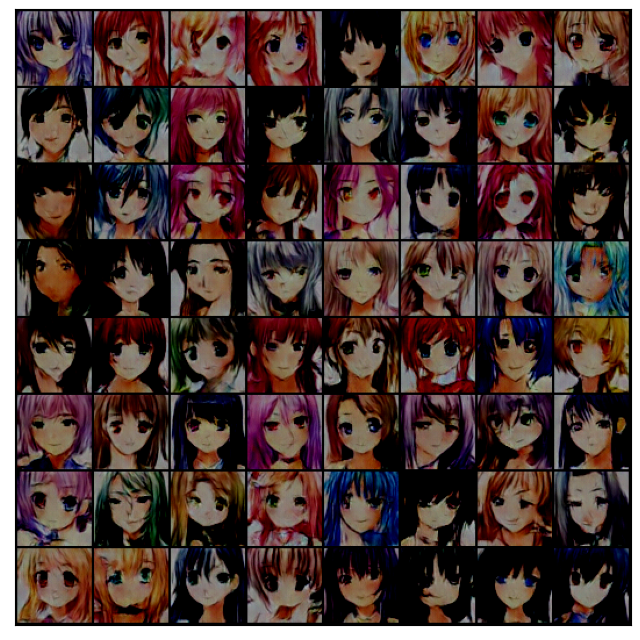

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [36/40], loss_g: 3.0393, loss_d: 0.4815, real_score: 0.9180, fake_score: 0.0940
Saving generated-images-0036.png


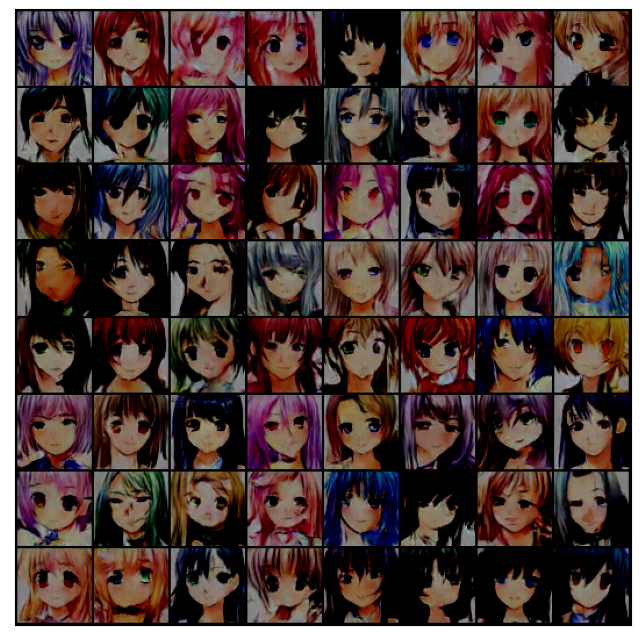

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [37/40], loss_g: 3.8839, loss_d: 0.7442, real_score: 0.8271, fake_score: 0.2456
Saving generated-images-0037.png


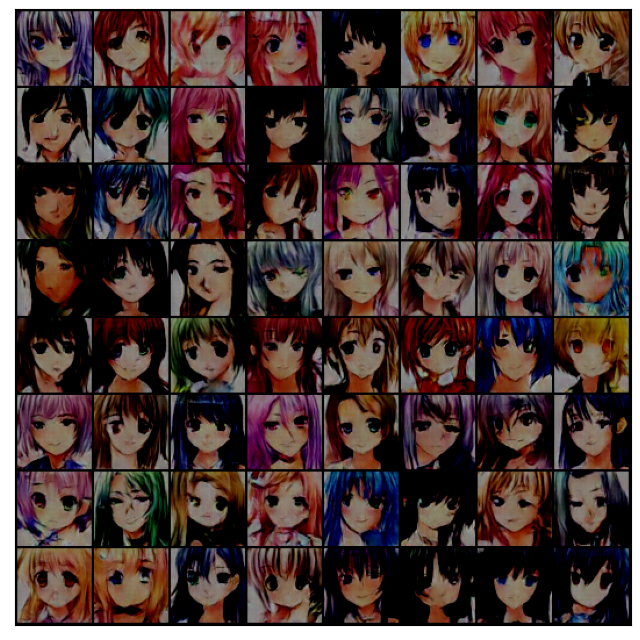

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [38/40], loss_g: 4.7782, loss_d: 0.5209, real_score: 0.9746, fake_score: 0.2024
Saving generated-images-0038.png


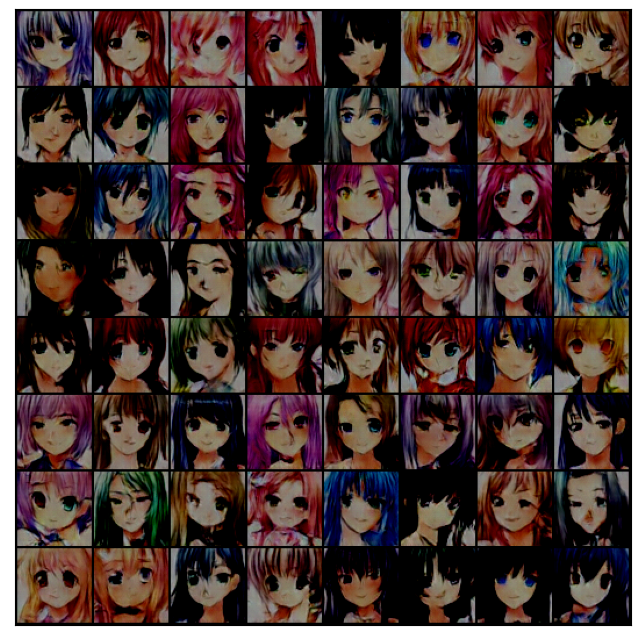

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [39/40], loss_g: 3.6791, loss_d: 0.4866, real_score: 0.9184, fake_score: 0.1658
Saving generated-images-0039.png


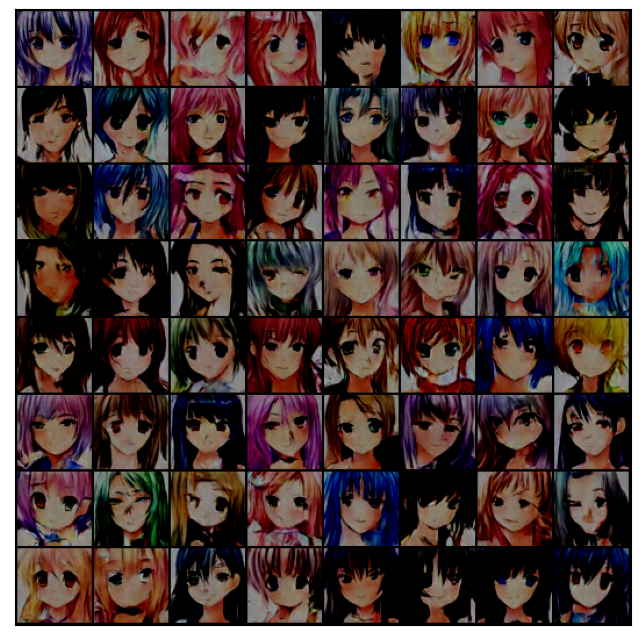

  0%|          | 0/575 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [40/40], loss_g: 3.6386, loss_d: 0.5320, real_score: 0.9120, fake_score: 0.1227
Saving generated-images-0040.png


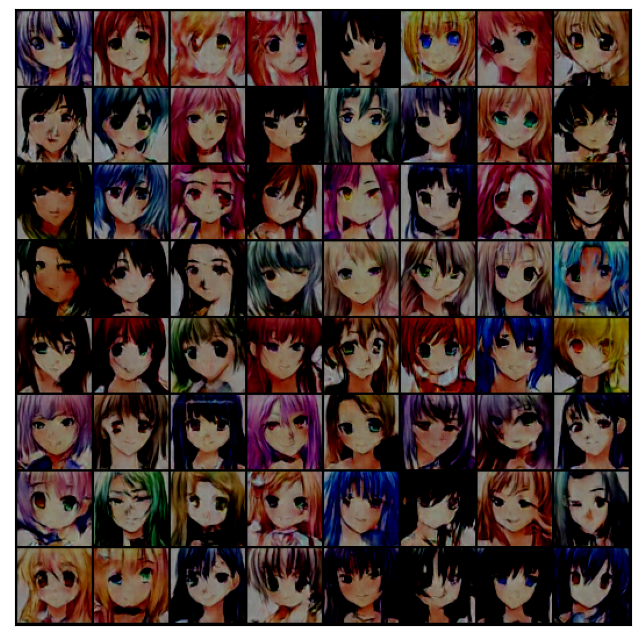

In [14]:
#TODO: Complete the training function
losses_g = []
losses_d = []
real_scores = []
fake_scores = []
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        real_h = []
        fake_h = []
        for real_images in tqdm(trainloader):
            real_images=real_images.to(device)
            # -----------------------------------------------
            #         YOUR CODE HERE: TRAIN THE NETWORKS
            # -----------------------------------------------
            # 1. Train the discriminator on real and fake images
            # Pass real images through discriminator
            d_optimizer.zero_grad()
            D_out_real = D(real_images)
            real_labels = (0.9 - 1) * torch.rand_like(D_out_real).to(device) + 1
            real_loss = Real_loss(D_out_real,real_labels)
            
            # Generate fake images
            noise = torch.randn(batch_size, latent_size, 1, 1).to(device)
            G_out = G(noise)
            
            # Pass fake images through discriminator
            D_out_fake = D(G_out)
            fake_labels = (0 - 0.1) * torch.rand_like(D_out_fake).to(device) + 0.1
            fake_loss = Fake_loss(D_out_fake, fake_labels)
            
            # Update discriminator weights
            loss_d = real_loss + fake_loss
            loss_d.backward(retain_graph=True)
            d_optimizer.step()
            
            
            ## 2. Train the generator with an adversarial loss
            # Generate fake images
            g_optimizer.zero_grad()

            # Try to fool the discriminator
            D_out_fake2 = D(G_out)
           
            # The label is set to 1(real-like) to fool the discriminator
            real_labels2 = torch.full(D_out_fake2.shape, 1.0).to(device)
            loss_g = Real_loss(D_out_fake2, real_labels2)
           
            # Update generator weights
            loss_g.backward()
            g_optimizer.step()
              
        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_h.append(np.sum(list(D_out_real.cpu().detach()))/len(D_out_real))
        fake_h.append(np.sum(list(D_out_fake.cpu().detach()))/len(D_out_fake))
        real_score = np.mean(real_h)
        fake_score = np.mean(fake_h)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        save_samples(epoch+start_idx, fixed_latent,G, show=True)
            
        state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
        state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
        if not os.path.isdir('checkpoint'):
            os.mkdir('checkpoint') 
        torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(D,G,opt_d,opt_g,epochs=40)

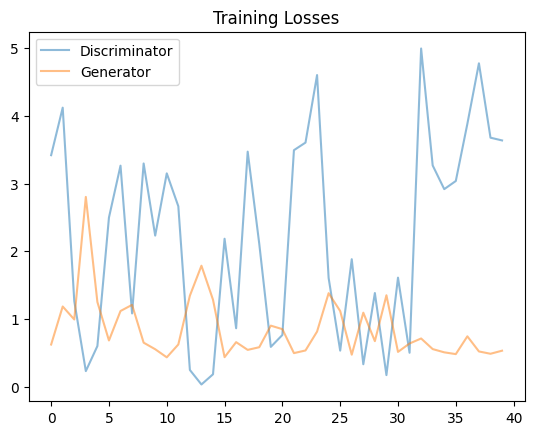

In [15]:
##Visualize your loss curve of D and G
fig, ax = plt.subplots()
plt.plot(losses_g, label='Discriminator', alpha=0.5)
plt.plot(losses_d, label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question1: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result

The samples created got better eventually, but couldn’t notice any improvements in the latter epochs. A deeper architecture would have benefited from greater number of epochs as it would be able to optimize more parameters. For further modeling one can try using different optimizers to generator and discriminator. To improve the performance of this model one can try to increase the dropout ratios in the discriminator architecture. This can solve the vanishing gradient problem. More hyperparameter techniques such as smaller learning rates, adding noise to the discriminator layers. 

### Question2: How does the training loss of the generator and the discriminator change during your training?

The training loss of the discriminator stays low whereas generator loss is quite stable. The losses of generator and discriminator are too far from each other to provide optimal training and performance of the network.

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "final_project_StudentNumber_StudentName.ipynb". Include the generated images in your submission.